# Data Cleaning, EDA, and NGrams - Stop Smoking
___
The idea here is to load in the created Alcoholics Anonymous CSV file and clean it up so the data will have no errors, null values, or empty values that may skew the result. We will also be doing a bit of preprocessing and data exploring and analysis to assist on how to filter the columns down to the point where we believe it will benefit us on solving our problem that we are exploring.
___

## Import Libraries
___

In [187]:
#import libraries
import pandas as pd
import nltk 
import numpy as np
import sklearn as sk
import matplotlib.pyplot as plt
import seaborn as sns
import re
import string

pd.set_option('display.max_colwidth', 100)

stopwords = nltk.corpus.stopwords.words('english')
ps = nltk.PorterStemmer()
wn = nltk.WordNetLemmatizer()

# Enables Pandas to display all the columns
pd.set_option('display.max_columns', None)

# Enables Pandas to display all the rows
pd.set_option('display.max_rows', None)

%matplotlib inline

#subriddet name
subriddet_name = 'stopsmoking'

# Pull in CSV file

In [188]:
#create instance for read csv file
messages = pd.read_csv('../data/Raw_Stop_Smoking.csv')

# Discover the Data

In [189]:
#display sample size of the whole dataframe
messages.head()

,Unnamed: 0,index,all_awardings,allow_live_comments,author,author_flair_css_class,author_flair_richtext,author_flair_text,author_flair_type,author_fullname,author_is_blocked,author_patreon_flair,author_premium,awarders,can_mod_post,contest_mode,created_utc,domain,full_link,gildings,id,is_created_from_ads_ui,is_crosspostable,is_meta,is_original_content,is_reddit_media_domain,is_robot_indexable,is_self,is_video,link_flair_background_color,link_flair_richtext,link_flair_text_color,link_flair_type,locked,media_only,no_follow,num_comments,num_crossposts,over_18,parent_whitelist_status,permalink,pinned,pwls,retrieved_on,score,selftext,send_replies,spoiler,stickied,subreddit,subreddit_id,subreddit_subscribers,subreddit_type,thumbnail,title,total_awards_received,treatment_tags,upvote_ratio,url,whitelist_status,wls,author_flair_template_id,author_flair_text_color,post_hint,preview,thumbnail_height,thumbnail_width,url_overridden_by_dest,removed_by_category,gallery_data,is_gallery,media_metadata,author_flair_background_color,edited,author_cakeday,crosspost_parent,crosspost_parent_list,poll_data,media,media_embed,secure_media,secure_media_embed,banned_by
0,0,0,[],False,Late_Night_Drives,NaN,[],NaN,text,t2_9exq60as,False,False,False,[],False,False,1636024295,self.stopsmoking,https://www.reddit.com/r/stopsmoking/comments/qmi9bn/its_possible_my_friends_difficult_but_possible/,{},qmi9bn,False,True,False,False,False,True,True,False,NaN,[],dark,text,False,False,False,0,0,False,no_ads,/r/stopsmoking/comments/qmi9bn/its_possible_my_friends_difficult_but_possible/,False,0.0,1636024305,1,"I'm now at 100 days. I can't believe it honestly. It was super difficult but I'm glad I did it. Honestly at this point the cravings aren't troublesome, however still existent. I think I won't be returning to this habit. \n\nAt one point due to my addiction, consuming nicotine became my personality. I was constantly inhaling this garbage. Literally every couple of minutes I needed to take a hit. My health started to deteriorate, blood levels weren't normal and doctors started to get concerned. I still didn't give a fuck. I was very stubborn. One day however, breathing just became impossible. I'm now on two inhalers as a result. It scares me straight. \n\nTrust me when I say this, it's possible to quit. It's not impossible. Don't be like me and have to deal with a health consequence (hopefully temporary) to motivate you to quit. Let my health problems motivate you to do better.\n\nIf you're considering quitting, I believe in you! If I can do it, so can you.",True,False,False,stopsmoking,t5_2rbuf,129434,public,self,"It's possible, my friends. Difficult, but possible!",0,[],1.0,https://www.reddit.com/r/stopsmoking/comments/qmi9bn/its_possible_my_friends_difficult_but_possible/,no_ads,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,1,[],False,countrycow2112,year1,[],1760 days,text,t2_f0w7w,False,False,False,[],False,False,1636022686,i.redd.it,https://www.reddit.com/r/stopsmoking/comments/qmhvb0/made_it_to_18_months_its_deffo_for_forever_this/,{},qmhvb0,False,True,False,False,True,True,False,False,NaN,[],dark,text,False,False,True,0,0,False,no_ads,/r/stopsmoking/comments/qmhvb0/made_it_to_18_months_its_deffo_for_forever_this/,False,0.0,1636022697,1,NaN,True,False,False,stopsmoking,t5_2rbuf,129434,public,image,Made it to 18 months. It's deffo for forever this time!,0,[],1.0,https://i.redd.it/e9oahewv5kx71.jpg,no_ads,0.0,bb3d9e6e-6c34-11e9-9f3e-0e7e3b6fa1a4,dark,image,"{'enabled': True, 'images': [{'id': 'g2RBZytrFEGM_nsyMZvjh1DoMzcnf6QVwxF0zRvbB40', 'resolutions': [{'height': 215, 'url': 'https://preview.redd.it/e9oahewv5kx71.jpg?width=108&amp;crop=smart&amp;auto=webp&amp;s=0361561970f927809f7732fcf6b1242859217782', 'width': 108}, {'height': 431, 'url': 'https://preview.redd.it/e9oahewv5kx71.jpg?width=216&amp;crop=smart&amp;auto=webp&amp;s=73f271b3ed6878a79f6dbc1930f500fa14826f3b', 'width': 216}, {'height': 639, 'url': 'htt

Because the website Reddit provides an extensive breakdown of each category, majority of them does not fit our critera as useful information.

In [190]:
#check the description
messages.describe()

,Unnamed: 0,index,created_utc,link_flair_background_color,num_comments,num_crossposts,pwls,retrieved_on,score,subreddit_subscribers,total_awards_received,upvote_ratio,wls,thumbnail_height,thumbnail_width,author_flair_background_color,edited
count,2000.000000,2000.000000,2.000000e+03,0.0,2000.000000,2000.0,1978.0,2.000000e+03,2000.000000,2000.000000,2000.00000,2000.000000,1978.0,402.000000,402.0,0.0,4.000000e+00
mean,999.500000,49.500000,1.633352e+09,NaN,6.090000,0.0,0.0,1.633353e+09,1.261000,128212.018000,0.00250,0.998395,0.0,131.430348,140.0,NaN,1.634684e+09
std,577.494589,28.873289,1.510416e+06,NaN,8.919455,0.0,0.0,1.510511e+06,3.231579,733.505379,0.04995,0.020067,0.0,18.373959,0.0,NaN,1.304637e+06
min,0.000000,0.000000,1.630797e+09,NaN,0.000000,0.0,0.0,1.630797e+09,0.000000,127070.000000,0.00000,0.500000,0.0,40.000000,140.0,NaN,1.633531e+09
25%,499.750000,24.750000,1.632027e+09,NaN,1.000000,0.0,0.0,1.632027e+09,1.000000,127542.000000,0.00000,1.000000,0.0,135.500000,140.0,NaN,1.633566e+09
50%,999.500000,49.500000,1.633286e+09,NaN,3.000000,0.0,0.0,1.633286e+09,1.000000,128042.000000,0.00000,1.000000,0.0,140.000000,140.0,NaN,1.634691e+09
75%,1499.250000,74.250000,1.634638e+09,NaN,8.000000,0.0,0.0,1.634638e+09,1.000000,128928.750000,0.00000,1.000000,0.0,140.000000,140.0,NaN,1.635809e+09
max,1999.000000,99.000000,1.636024e+09,NaN,127.000000,0.0,0.0,1.636024e+09,93.000000,129434.000000,1.00000,1.000000,0.0,140.000000,140.0,NaN,1.635822e+09


In [191]:
#display info
messages.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2000 entries, 0 to 1999
Data columns (total 83 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   Unnamed: 0                     2000 non-null   int64  
 1   index                          2000 non-null   int64  
 2   all_awardings                  2000 non-null   object 
 3   allow_live_comments            2000 non-null   bool   
 4   author                         2000 non-null   object 
 5   author_flair_css_class         204 non-null    object 
 6   author_flair_richtext          1990 non-null   object 
 7   author_flair_text              204 non-null    object 
 8   author_flair_type              1990 non-null   object 
 9   author_fullname                1990 non-null   object 
 10  author_is_blocked              2000 non-null   bool   
 11  author_patreon_flair           1990 non-null   object 
 12  author_premium                 1990 non-null   o

Since the project's problem statement is related to determining which subreddit the author's post should belong to, we'll be filtering down the large set of predetermined columns to the ones we believe will affect our study.

## Filter Columns to Fit Study's Need

In [192]:
#filter out the one that will be useful for study
filtered_messages = messages.filter(['author', 'title', 'selftext', 'subreddit'])

In [193]:
#see sample of filtered dataframe
filtered_messages.head()

,author,title,selftext,subreddit
0,Late_Night_Drives,"It's possible, my friends. Difficult, but possible!","I'm now at 100 days. I can't believe it honestly. It was super difficult but I'm glad I did it. Honestly at this point the cravings aren't troublesome, however still existent. I think I won't be returning to this habit. \n\nAt one point due to my addiction, consuming nicotine became my personality. I was constantly inhaling this garbage. Literally every couple of minutes I needed to take a hit. My health started to deteriorate, blood levels weren't normal and doctors started to get concerned. I still didn't give a fuck. I was very stubborn. One day however, breathing just became impossible. I'm now on two inhalers as a result. It scares me straight. \n\nTrust me when I say this, it's possible to quit. It's not impossible. Don't be like me and have to deal with a health consequence (hopefully temporary) to motivate you to quit. Let my health problems motivate you to do better.\n\nIf you're considering quitting, I believe in you! If I can do it, so can you.",stopsmoking
1,countrycow2112,Made it to 18 months. It's deffo for forever this time!,NaN,stopsmoking
2,Altruistic_Ad5297,I need help,"I've been a heavy smoker for a quite sometime smoking around 2 packs a day I quit few times the longest being around 2.5 months, around a month and half ago I decided I want to take better care of myself and my health and work on my running (my biggest dream is to become an elite runner and that doesn't really go well with smoking.)\n\nI've been doing great, Ive felt like I've been happy for the first time in so long and I was feeling like I can breath on my runs for the first time ever, but this weekend I went on a vacation with some co-workers and I got so drunk and smoked so much.\n\nI told myself that I'm in control and I won't let this be my relapse, I made it for a couple of days but today I smoked two cigarettes.\n\nI feel crushed and I'm losing meaning of life, I don't want to go back to the smoking life and I also don't want to live my life moping for a cigarette, I really don't know what to do I feel like I hate myself and my life. I'm stuck in a loop that I don't know how to get out.\n\nMaybe it's worth mentioning that I live with two roommates that both smokes and the smell is so triggering I can't begin to describe it. \n\nHow did you break the loop? does it ever get better?\n\nI feel like I'm a hopeless case and I don't want to live like this anymore, I really need some advice on how to not relapse again.",stopsmoking
3,Scary-Life-5543,Day 12!! ☺️☺️,I posted about my first attempt to quit here and that lasted 5 days. I got some lovely advice and encouragement from this wonderful community and I decided to have another go.\n\nIm 12 days nicotine free today!! Im so happy and proud of myself. It can be a bit difficult handling the withdrawals and I find myself very irritable sometimes. But im taking it one day at a time!! \n\nCheers to nicotine free lungs for good! ❤️ \nWishing you all luck in your journeys and im here to say it’s okay if you slip. Just get back on the wagon and make sure it doesn’t happen again. I believe in all of you.,stopsmoking
4,Party_Wounds,"Today, I quit cold turkey, after 4 years of smoking.","As the title says, I decided enough is enough. My girlfriend quit 3 weeks ago, but I was stubborn, for some weird reason I just kept smoking. I got to the point where I smoke a pack a day, sometimes more. \n\nI want to be healthy, to cope with stress some other way, and be there for my girlfriend (future wife) and, God willing, my kids.\n\nSo I guess I'll be hanging around here, if you have any advice or just a comment of support, feel free to write!",stopsmoking


### Determine if there are any relationship between number of post to the authors

In [194]:
#see who is contributing the most
filtered_messages['author'].value_counts()

minimalisticlife007     19
HMo83                   14
HoraceSense             13
blueberrytassels        11
karmachidi              11
[deleted]               10
Odd-Association-891      9
Majobar                  8
TiranaBoy                8
poppycube                7
Bec-C-Art                7
SmallChanges8364         7
suckroom                 7
Apprehensive_Beat840     6
Jordie_Chelle084         6
Crystal-Clear75          6
Arwen-Newton             6
cleanblueair             5
whateveriamtired         5
Sweet-Bunch6667          5
flex_boy                 5
anonymouser117           5
billiecody94             5
PUK2                     5
x9u9y9ux                 5
gambleroflives91         5
Rustywrench08            5
lilitheflower314         5
MaynardSchism            5
Snoo_96358               5
VelvetineDragon          4
Nickslife89              4
Trash_Vamp               4
NoFapUser1212            4
MUSCstudies              4
brightback73             4
thatguyoverthur          4
O

The author, "**HoraceSense**" seems to be the top contributor for the Stop Smoking subreddit.   After futher study, we found out that this author is very open with his life.

### Determine the number of null values in the filtered messages dataframe

In [195]:
#display filtered infomation to see if the types, number of non-null count and filtered columns checks out
filtered_messages.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2000 entries, 0 to 1999
Data columns (total 4 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   author     2000 non-null   object
 1   title      2000 non-null   object
 2   selftext   1476 non-null   object
 3   subreddit  2000 non-null   object
dtypes: object(4)
memory usage: 62.6+ KB


In [196]:
#number of nulled files in selftext column
print("There are " + str(filtered_messages['selftext'].isnull().sum()) + " of Null values.")

There are 524 of Null values.


### Determine the number of null values should be dropped or find alternatives

In [197]:
#read a sample amount of nulled selftext to see if we can drop them
filtered_messages[filtered_messages['selftext'].isnull()].head()

,author,title,selftext,subreddit
1,countrycow2112,Made it to 18 months. It's deffo for forever this time!,NaN,stopsmoking
6,qvnf,How big tobacco made cigarettes more addictive,NaN,stopsmoking
17,minimalisticlife007,"Altab, ex friend called me after a long time, ended up smoking cigarettes with him. Almost 2 days cold turkey lost. Starting quitting again.",NaN,stopsmoking
20,balqryus,Anyone here noticed ‘cleaner’ (more clear) boogers ? Lol - sorry a bit yucky but oh well had to ask.,NaN,stopsmoking
30,pinbreak,"Help me if you can I'm feeling down - Help, John Lennon",NaN,stopsmoking


___
Although the selftext column does contain null values, some title column within the sample does have enough information that can be used for the study. Therefore, we will replace the null values as 'None' as this is a personal comment from the author so we cannot be the judge and provide a filler answer to the empty space.
___

In [198]:
#convert the null value to None value because it has the biggest percentage 
filtered_messages['selftext'] = filtered_messages['selftext'].replace(np.nan, 'None')

In [199]:
#see if there are anymore null values in selftext column
print("There are " + str(filtered_messages['selftext'].isnull().sum()) + " of Null values.")

There are 0 of Null values.


In [200]:
#create a decending order to see who posted the most and the number of posts the author has contributed
num_authors = filtered_messages.groupby('author')['selftext'].count().sort_values(ascending=False)
num_authors.head(10)

author
minimalisticlife007    19
HMo83                  14
HoraceSense            13
blueberrytassels       11
karmachidi             11
[deleted]              10
Odd-Association-891     9
Majobar                 8
TiranaBoy               8
poppycube               7
Name: selftext, dtype: int64

### Find the duplicates and drop them

In [201]:
#find out if there are any duplicate posts under selftext columns
filtered_messages.duplicated().sum()

5

In [202]:
#find out where are the duplicates
filtered_messages[filtered_messages.duplicated()]

,author,title,selftext,subreddit
1545,userthrowaway121012,10 Weeks smoke free!,None,stopsmoking
1665,brightback73,Kabhi Kabhi Toh Lage Har Din Mushkil Aur Har Pal Ek Saza,[removed],stopsmoking
1699,unknown_54678,Teenager trying to quit.,[removed],stopsmoking
1701,unknown_54678,Teenager trying to quit.,[removed],stopsmoking
1823,Alan_007,"This is like my Nth attempt, hope this is the final one. Good luck 🤞",None,stopsmoking


In [203]:
#Because there is only one duplicate within the whole filtered data set, it safe to drop it
filtered_messages.drop_duplicates(inplace=True)

In [204]:
#check if there are anymore duplicates
filtered_messages.duplicated().sum()

0

In [205]:
#confirm that the number of non-null counts are the same through all the columns
filtered_messages.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1995 entries, 0 to 1999
Data columns (total 4 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   author     1995 non-null   object
 1   title      1995 non-null   object
 2   selftext   1995 non-null   object
 3   subreddit  1995 non-null   object
dtypes: object(4)
memory usage: 77.9+ KB


In [206]:
#create a new dataset to prevent any errors
filtered_messages_df = filtered_messages
mod_filtered_messages_df = filtered_messages_df[['selftext', 'subreddit']]
#mod_filtered_messages_df.head()
mod_filtered_messages_df.to_csv('../data/Clean_Data_SS_Filtered_Messages_DF.csv', index=None)

# Clean Title Column
___

## Remove Punctuations

In [207]:
# string.punctuation comprises of a list of all punctuations
import string
string.punctuation

'!"#$%&\'()*+,-./:;<=>?@[\\]^_`{|}~'

In [208]:
def remove_punct(text):
    # store character only if it is not a punctuation
    text_nopunct = "".join([char for char in text if char not in string.punctuation])
    return text_nopunct

filtered_messages['title_clean'] = filtered_messages['title'].apply(lambda x: remove_punct(x))

filtered_messages.head()

,author,title,selftext,subreddit,title_clean
0,Late_Night_Drives,"It's possible, my friends. Difficult, but possible!","I'm now at 100 days. I can't believe it honestly. It was super difficult but I'm glad I did it. Honestly at this point the cravings aren't troublesome, however still existent. I think I won't be returning to this habit. \n\nAt one point due to my addiction, consuming nicotine became my personality. I was constantly inhaling this garbage. Literally every couple of minutes I needed to take a hit. My health started to deteriorate, blood levels weren't normal and doctors started to get concerned. I still didn't give a fuck. I was very stubborn. One day however, breathing just became impossible. I'm now on two inhalers as a result. It scares me straight. \n\nTrust me when I say this, it's possible to quit. It's not impossible. Don't be like me and have to deal with a health consequence (hopefully temporary) to motivate you to quit. Let my health problems motivate you to do better.\n\nIf you're considering quitting, I believe in you! If I can do it, so can you.",stopsmoking,Its possible my friends Difficult but possible
1,countrycow2112,Made it to 18 months. It's deffo for forever this time!,None,stopsmoking,Made it to 18 months Its deffo for forever this time
2,Altruistic_Ad5297,I need help,"I've been a heavy smoker for a quite sometime smoking around 2 packs a day I quit few times the longest being around 2.5 months, around a month and half ago I decided I want to take better care of myself and my health and work on my running (my biggest dream is to become an elite runner and that doesn't really go well with smoking.)\n\nI've been doing great, Ive felt like I've been happy for the first time in so long and I was feeling like I can breath on my runs for the first time ever, but this weekend I went on a vacation with some co-workers and I got so drunk and smoked so much.\n\nI told myself that I'm in control and I won't let this be my relapse, I made it for a couple of days but today I smoked two cigarettes.\n\nI feel crushed and I'm losing meaning of life, I don't want to go back to the smoking life and I also don't want to live my life moping for a cigarette, I really don't know what to do I feel like I hate myself and my life. I'm stuck in a loop that I don't know how to get out.\n\nMaybe it's worth mentioning that I live with two roommates that both smokes and the smell is so triggering I can't begin to describe it. \n\nHow did you break the loop? does it ever get better?\n\nI feel like I'm a hopeless case and I don't want to live like this anymore, I really need some advice on how to not relapse again.",stopsmoking,I need help
3,Scary-Life-5543,Day 12!! ☺️☺️,I posted about my first attempt to quit here and that lasted 5 days. I got some lovely advice and encouragement from this wonderful community and I decided to have another go.\n\nIm 12 days nicotine free today!! Im so happy and proud of myself. It can be a bit difficult handling the withdrawals and I find myself very irritable sometimes. But im taking it one day at a time!! \n\nCheers to nicotine free lungs for good! ❤️ \nWishing you all luck in your journeys and im here to say it’s okay if you slip. Just get back on the wagon and make sure it doesn’t happen again. I believe in all of you.,stopsmoking,Day 12 ☺️☺️
4,Party_Wounds,"Today, I quit cold turkey, after 4 years of smoking.","As the title says, I decided enough is enough. My girlfriend quit 3 weeks ago, but I was stubborn, for some weird reason I just kept smoking. I got to the point where I smoke a pack a day, sometimes more. \n\nI want to be healthy, to cope with stress some other way, and be there for my girlfriend (future wife) and, God willing, my kids.\n\nSo I guess I'll be hanging around here, if you have any advice or just a comment of support, feel free to write!",stopsmoking,Today I quit cold turkey after 4 years of smoking


## Tokenization

In [209]:
import re

def tokenize(text):
    # \W matches any non-word character (equivalent to [^a-zA-Z0-9_]). This does not include spaces i.e. \s
    # Add a + just in case there are 2 or more spaces between certain words
    tokens = re.split('\W+', text)
    return tokens

filtered_messages['title_clean_tokenized'] = filtered_messages['title_clean'].apply(lambda x: tokenize(x.lower()))

filtered_messages.head()

,author,title,selftext,subreddit,title_clean,title_clean_tokenized
0,Late_Night_Drives,"It's possible, my friends. Difficult, but possible!","I'm now at 100 days. I can't believe it honestly. It was super difficult but I'm glad I did it. Honestly at this point the cravings aren't troublesome, however still existent. I think I won't be returning to this habit. \n\nAt one point due to my addiction, consuming nicotine became my personality. I was constantly inhaling this garbage. Literally every couple of minutes I needed to take a hit. My health started to deteriorate, blood levels weren't normal and doctors started to get concerned. I still didn't give a fuck. I was very stubborn. One day however, breathing just became impossible. I'm now on two inhalers as a result. It scares me straight. \n\nTrust me when I say this, it's possible to quit. It's not impossible. Don't be like me and have to deal with a health consequence (hopefully temporary) to motivate you to quit. Let my health problems motivate you to do better.\n\nIf you're considering quitting, I believe in you! If I can do it, so can you.",stopsmoking,Its possible my friends Difficult but possible,"[its, possible, my, friends, difficult, but, possible]"
1,countrycow2112,Made it to 18 months. It's deffo for forever this time!,None,stopsmoking,Made it to 18 months Its deffo for forever this time,"[made, it, to, 18, months, its, deffo, for, forever, this, time]"
2,Altruistic_Ad5297,I need help,"I've been a heavy smoker for a quite sometime smoking around 2 packs a day I quit few times the longest being around 2.5 months, around a month and half ago I decided I want to take better care of myself and my health and work on my running (my biggest dream is to become an elite runner and that doesn't really go well with smoking.)\n\nI've been doing great, Ive felt like I've been happy for the first time in so long and I was feeling like I can breath on my runs for the first time ever, but this weekend I went on a vacation with some co-workers and I got so drunk and smoked so much.\n\nI told myself that I'm in control and I won't let this be my relapse, I made it for a couple of days but today I smoked two cigarettes.\n\nI feel crushed and I'm losing meaning of life, I don't want to go back to the smoking life and I also don't want to live my life moping for a cigarette, I really don't know what to do I feel like I hate myself and my life. I'm stuck in a loop that I don't know how to get out.\n\nMaybe it's worth mentioning that I live with two roommates that both smokes and the smell is so triggering I can't begin to describe it. \n\nHow did you break the loop? does it ever get better?\n\nI feel like I'm a hopeless case and I don't want to live like this anymore, I really need some advice on how to not relapse again.",stopsmoking,I need help,"[i, need, help]"
3,Scary-Life-5543,Day 12!! ☺️☺️,I posted about my first attempt to quit here and that lasted 5 days. I got some lovely advice and encouragement from this wonderful community and I decided to have another go.\n\nIm 12 days nicotine free today!! Im so happy and proud of myself. It can be a bit difficult handling the withdrawals and I find myself very irritable sometimes. But im taking it one day at a time!! \n\nCheers to nicotine free lungs for good! ❤️ \nWishing you all luck in your journeys and im here to say it’s okay if you slip. Just get back on the wagon and make sure it doesn’t happen again. I believe in all of you.,stopsmoking,Day 12 ☺️☺️,"[day, 12, ]"
4,Party_Wounds,"Today, I quit cold turkey, after 4 years of smoking.","As the title says, I decided enough is enough. My girlfriend quit 3 weeks ago, but I was stubborn, for some weird reason I just kept smoking. I got to the point where I smoke a pack a day, sometimes more. \n\nI want to be healthy, to cope with stress some other way, and be there for my girlfriend (future wife) and, God willing, my kids.\n\nSo I guess I'll be hanging around here, if you have any advice o

## For Title: Remove stopewords

In [210]:
import nltk

#using English as the base for all the stopwords
stopword = nltk.corpus.stopwords.words('english')

#create a function that removes all the default stopwords
def remove_stopwords(tokenized_list):
    # Store in text only if word is not found in stopword
    text = [word for word in tokenized_list if word not in stopword]
    return text

#create a new column for cleaned set of words without any stopwords
filtered_messages['title_clean_nostopwords'] = filtered_messages['title_clean_tokenized'].apply(lambda x: remove_stopwords(x))

#display a sample size of the updated dataframe
filtered_messages.head()

,author,title,selftext,subreddit,title_clean,title_clean_tokenized,title_clean_nostopwords
0,Late_Night_Drives,"It's possible, my friends. Difficult, but possible!","I'm now at 100 days. I can't believe it honestly. It was super difficult but I'm glad I did it. Honestly at this point the cravings aren't troublesome, however still existent. I think I won't be returning to this habit. \n\nAt one point due to my addiction, consuming nicotine became my personality. I was constantly inhaling this garbage. Literally every couple of minutes I needed to take a hit. My health started to deteriorate, blood levels weren't normal and doctors started to get concerned. I still didn't give a fuck. I was very stubborn. One day however, breathing just became impossible. I'm now on two inhalers as a result. It scares me straight. \n\nTrust me when I say this, it's possible to quit. It's not impossible. Don't be like me and have to deal with a health consequence (hopefully temporary) to motivate you to quit. Let my health problems motivate you to do better.\n\nIf you're considering quitting, I believe in you! If I can do it, so can you.",stopsmoking,Its possible my friends Difficult but possible,"[its, possible, my, friends, difficult, but, possible]","[possible, friends, difficult, possible]"
1,countrycow2112,Made it to 18 months. It's deffo for forever this time!,None,stopsmoking,Made it to 18 months Its deffo for forever this time,"[made, it, to, 18, months, its, deffo, for, forever, this, time]","[made, 18, months, deffo, forever, time]"
2,Altruistic_Ad5297,I need help,"I've been a heavy smoker for a quite sometime smoking around 2 packs a day I quit few times the longest being around 2.5 months, around a month and half ago I decided I want to take better care of myself and my health and work on my running (my biggest dream is to become an elite runner and that doesn't really go well with smoking.)\n\nI've been doing great, Ive felt like I've been happy for the first time in so long and I was feeling like I can breath on my runs for the first time ever, but this weekend I went on a vacation with some co-workers and I got so drunk and smoked so much.\n\nI told myself that I'm in control and I won't let this be my relapse, I made it for a couple of days but today I smoked two cigarettes.\n\nI feel crushed and I'm losing meaning of life, I don't want to go back to the smoking life and I also don't want to live my life moping for a cigarette, I really don't know what to do I feel like I hate myself and my life. I'm stuck in a loop that I don't know how to get out.\n\nMaybe it's worth mentioning that I live with two roommates that both smokes and the smell is so triggering I can't begin to describe it. \n\nHow did you break the loop? does it ever get better?\n\nI feel like I'm a hopeless case and I don't want to live like this anymore, I really need some advice on how to not relapse again.",stopsmoking,I need help,"[i, need, help]","[need, help]"
3,Scary-Life-5543,Day 12!! ☺️☺️,I posted about my first attempt to quit here and that lasted 5 days. I got some lovely advice and encouragement from this wonderful community and I decided to have another go.\n\nIm 12 days nicotine free today!! Im so happy and proud of myself. It can be a bit difficult handling the withdrawals and I find myself very irritable sometimes. But im taking it one day at a time!! \n\nCheers to nicotine free lungs for good! ❤️ \nWishing you all luck in your journeys and im here to say it’s okay if you slip. Just get back on the wagon and make sure it doesn’t happen again. I believe in all of you.,stopsmoking,Day 12 ☺️☺️,"[day, 12, ]","[day, 12, ]"
4,Party_Wounds,"Today, I quit cold turkey, after 4 years of smoking.","As the title says, I decided enough is enough. My girlfriend quit 3 weeks ago, but I was stubborn, for some weird reason I just kept smoking. I got to the point where I smoke a pack a day, sometimes more. \n\nI want to be healthy, to cope with stress some other way, 

In [211]:
#create an instance for lemmatizer function
wn = nltk.WordNetLemmatizer()

#create a function to lemmatizing the tokened words
def lemmatizing(tokenized_text):
    # return list of all lemmatized words for their corresponding words in tokenized_text
    text = [wn.lemmatize(word) for word in tokenized_text]
    return text

#add new column for the lammatizied words
filtered_messages['title_clean_lemmatized'] = filtered_messages['title_clean_nostopwords'].apply(lambda x: lemmatizing(x))

#display a sample of the updated dataframe
filtered_messages.head(10)

,author,title,selftext,subreddit,title_clean,title_clean_tokenized,title_clean_nostopwords,title_clean_lemmatized
0,Late_Night_Drives,"It's possible, my friends. Difficult, but possible!","I'm now at 100 days. I can't believe it honestly. It was super difficult but I'm glad I did it. Honestly at this point the cravings aren't troublesome, however still existent. I think I won't be returning to this habit. \n\nAt one point due to my addiction, consuming nicotine became my personality. I was constantly inhaling this garbage. Literally every couple of minutes I needed to take a hit. My health started to deteriorate, blood levels weren't normal and doctors started to get concerned. I still didn't give a fuck. I was very stubborn. One day however, breathing just became impossible. I'm now on two inhalers as a result. It scares me straight. \n\nTrust me when I say this, it's possible to quit. It's not impossible. Don't be like me and have to deal with a health consequence (hopefully temporary) to motivate you to quit. Let my health problems motivate you to do better.\n\nIf you're considering quitting, I believe in you! If I can do it, so can you.",stopsmoking,Its possible my friends Difficult but possible,"[its, possible, my, friends, difficult, but, possible]","[possible, friends, difficult, possible]","[possible, friend, difficult, possible]"
1,countrycow2112,Made it to 18 months. It's deffo for forever this time!,None,stopsmoking,Made it to 18 months Its deffo for forever this time,"[made, it, to, 18, months, its, deffo, for, forever, this, time]","[made, 18, months, deffo, forever, time]","[made, 18, month, deffo, forever, time]"
2,Altruistic_Ad5297,I need help,"I've been a heavy smoker for a quite sometime smoking around 2 packs a day I quit few times the longest being around 2.5 months, around a month and half ago I decided I want to take better care of myself and my health and work on my running (my biggest dream is to become an elite runner and that doesn't really go well with smoking.)\n\nI've been doing great, Ive felt like I've been happy for the first time in so long and I was feeling like I can breath on my runs for the first time ever, but this weekend I went on a vacation with some co-workers and I got so drunk and smoked so much.\n\nI told myself that I'm in control and I won't let this be my relapse, I made it for a couple of days but today I smoked two cigarettes.\n\nI feel crushed and I'm losing meaning of life, I don't want to go back to the smoking life and I also don't want to live my life moping for a cigarette, I really don't know what to do I feel like I hate myself and my life. I'm stuck in a loop that I don't know how to get out.\n\nMaybe it's worth mentioning that I live with two roommates that both smokes and the smell is so triggering I can't begin to describe it. \n\nHow did you break the loop? does it ever get better?\n\nI feel like I'm a hopeless case and I don't want to live like this anymore, I really need some advice on how to not relapse again.",stopsmoking,I need help,"[i, need, help]","[need, help]","[need, help]"
3,Scary-Life-5543,Day 12!! ☺️☺️,I posted about my first attempt to quit here and that lasted 5 days. I got some lovely advice and encouragement from this wonderful community and I decided to have another go.\n\nIm 12 days nicotine free today!! Im so happy and proud of myself. It can be a bit difficult handling the withdrawals and I find myself very irritable sometimes. But im taking it one day at a time!! \n\nCheers to nicotine free lungs for good! ❤️ \nWishing you all luck in your journeys and im here to say it’s okay if you slip. Just get back on the wagon and make sure it doesn’t happen again. I believe in all of you.,stopsmoking,Day 12 ☺️☺️,"[day, 12, ]","[day, 12, ]","[day, 12, ]"
4,Party_Wounds,"Today, I quit cold turkey, after 4 years of smoking.","As the title says, I decided enough is enough. My girlfriend quit 3 weeks ago, but I was stubborn, for some weird reason I just kep

# For Title: Lemmatize the text

In [212]:
def clean_text(title_text):
    title_text = "".join([word.lower() for word in title_text if word not in string.punctuation])
    # \W matches any non-word character (equivalent to [^a-zA-Z0-9_]). This does not include spaces i.e. \s
    # Add a + just in case there are 2 or more spaces between certain words
    tokens = re.split('\W+', title_text)
    
    # apply stemming and stopwords exclusion within the same step
    title_text = [wn.lemmatize(word) for word in tokens if word not in stopwords]
    return title_text

### For Title: Apply CountVectorizer

In [213]:
from sklearn.feature_extraction.text import CountVectorizer

# Create an instance of CountVectorizer and pass in the clean_text function as the analyzer parameter
title_count_vect = CountVectorizer(analyzer=clean_text)

#title_X_counts stores the vectorized version of the data
title_X_counts = title_count_vect.fit_transform(filtered_messages['title'])

# Returns the number of rows and columns of X_counts i.e. 5567 text messages and 8104 unique words
print(title_X_counts.shape)

#create spacing
print('\n')

# Returns the unique words across alll text messages
print(title_count_vect.get_feature_names())

(1995, 2365)


['', '0', '01012021', '01november2021', '1', '10', '100', '1000', '100000', '1000calorie', '100x', '101', '101221', '101521', '10th', '11', '110', '1100', '1157pm', '119', '12', '120', '123', '1234', '127', '12kg', '13', '13092021', '138', '14', '145', '14mg', '15', '150', '15002000', '150pm', '150th', '152', '15mg', '15months', '15years', '16', '16yrs', '17', '18', '1825', '18th', '19', '1994', '19k', '1m', '1month', '1st', '1½', '2', '20', '2000', '2020', '2021', '2030', '21', '213', '22', '22m', '22nd', '23', '23m', '24', '24h', '24hrs', '24hs', '25', '250', '2510', '26', '26m', '26th', '27', '27000', '27yrs', '28', '29', '2nd', '3', '30', '3000', '30y', '32', '321', '32m', '33', '34', '35', '3540', '36', '36m', '36th', '37', '39', '3day', '3rd', '3weeks', '4', '40', '400000', '400m', '41', '43', '44', '45', '47', '48', '485', '49', '4months', '4th', '5', '50', '500', '501', '50kg', '51', '510', '51bpm', '52', '525', '538', '543', '55', '55yrs', '56', '59', '599', '5k

### For Title: Apply CountVectorizer to smaller sample

In [214]:
title_data_sample = filtered_messages[0:500]

title_count_vect_sample = CountVectorizer(analyzer=clean_text, max_features=100)
title_X_counts_sample = title_count_vect_sample.fit_transform(title_data_sample['title'])
print(title_X_counts_sample.shape)
print("\n")
print(title_count_vect_sample.get_feature_names())

(500, 100)


['', '1', '10', '2', '24', '3', '4', '5', '6', '7', '8', 'addiction', 'advice', 'ago', 'almost', 'amp', 'another', 'anyone', 'away', 'back', 'bad', 'big', 'cannabis', 'cant', 'cigarette', 'cold', 'could', 'craving', 'day', 'dont', 'easy', 'effect', 'even', 'far', 'feel', 'feeling', 'finally', 'first', 'free', 'friend', 'get', 'getting', 'go', 'going', 'good', 'got', 'guy', 'hard', 'help', 'hour', 'im', 'ive', 'keep', 'know', 'last', 'let', 'like', 'long', 'made', 'make', 'month', 'much', 'need', 'never', 'nicotine', 'nonsmoker', 'one', 'people', 'proud', 'quit', 'quitting', 'really', 'relapse', 'relapsed', 'right', 'smoke', 'smoked', 'smoker', 'smoking', 'started', 'starting', 'still', 'stop', 'stopped', 'thought', 'time', 'tobacco', 'today', 'trying', 'turkey', 'two', 'urge', 'want', 'way', 'week', 'well', 'without', 'work', 'would', 'year']


### For Title: Vectorizers output sparse matrices

In [215]:
title_X_counts_sample

<500x100 sparse matrix of type '<class 'numpy.int64'>'
	with 1523 stored elements in Compressed Sparse Row format>

In [216]:
# Due to the nature of sparse matrices where only non-zero elements are stored, 
# we would need to expand it out to a collection of arrays and then store it in a data frame
title_X_counts_df = pd.DataFrame(title_X_counts_sample.toarray())
title_X_counts_df

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1
5,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0
7,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
8,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
9,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [217]:
#create name for each column base from the words stored
title_X_counts_df.columns = title_count_vect_sample.get_feature_names()

#display the vectorized dataframe for title
title_X_counts_df

,,1,10,2,24,3,4,5,6,7,8,addiction,advice,ago,almost,amp,another,anyone,away,back,bad,big,cannabis,cant,cigarette,cold,could,craving,day,dont,easy,effect,even,far,feel,feeling,finally,first,free,friend,get,getting,go,going,good,got,guy,hard,help,hour,im,ive,keep,know,last,let,like,long,made,make,month,much,need,never,nicotine,nonsmoker,one,people,proud,quit,quitting,really,relapse,relapsed,right,smoke,smoked,smoker,smoking,started,starting,still,stop,stopped,thought,time,tobacco,today,trying,turkey,two,urge,want,way,week,well,without,work,would,year
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1
5,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0
7,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
8,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
9,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


## EDA: Find out what are the top words used for Title Data set

In [218]:
#create a feature name dataframe for title column
filtered_messages_title_matrix = pd.DataFrame(title_X_counts_df, columns=title_count_vect.get_feature_names())

#showcase the top 50 words used in the title column 
filtered_messages_title_matrix.sum().sort_values(ascending=False).head(50)

day          122.0
smoking       95.0
quit          65.0
month         47.0
              43.0
smoke         42.0
cigarette     39.0
quitting      38.0
cold          33.0
turkey        33.0
year          32.0
week          31.0
time          29.0
im            29.0
stop          24.0
like          24.0
3             23.0
1             22.0
free          21.0
nicotine      21.0
one           19.0
get           19.0
craving       19.0
feel          18.0
going         17.0
help          17.0
last          17.0
today         17.0
2             17.0
smoker        16.0
first         16.0
4             15.0
back          15.0
advice        14.0
made          13.0
7             12.0
thought       12.0
know          12.0
need          12.0
go            12.0
easy          11.0
really        11.0
hour          11.0
two           11.0
good          11.0
friend        11.0
feeling       10.0
would         10.0
ive           10.0
relapse       10.0
dtype: float64

Text(0.5, 1.0, 'Top 15 Most Used Words')

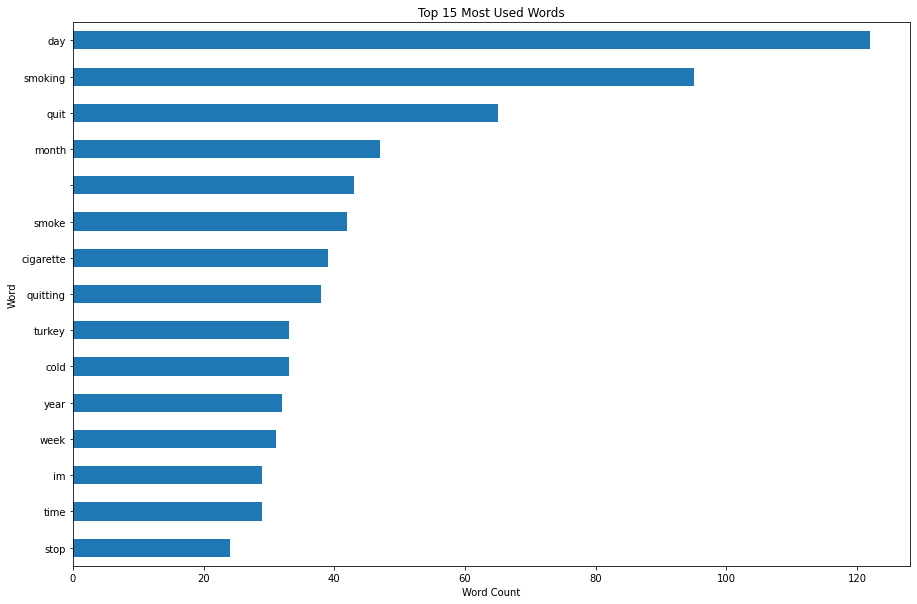

In [219]:
#create a horizontal Bar plot to visualize the top 15 words
plt.figure(figsize=(15,10))
filtered_messages_title_matrix.sum().sort_values(ascending=True).tail(15).plot(kind='barh')
plt.xlabel('Word Count')
plt.ylabel('Word')
plt.title('Top 15 Most Used Words')

As illustrated above, the some of the most common words used are words that may not have an impact to help identify in regards to Stop Smoking threads. To take a better look, we can use the bigrams in N-Grams to see if the the neighboring word may better identify the differentiation to our problem statement

# Vectorizing Title column: N-Grams

### For Title Column: Create function to remove punctuation, tokenize, remove stopwords, and lemmatize

In [220]:
def clean_text(title_text_ngram):
    title_text_ngram = "".join([word.lower() for word in title_text_ngram if word not in string.punctuation])
    title_tokens = re.split('\W+', title_text_ngram)
    # Requires a full sentence to be passed in as opposed to a tokenized list
    title_text_ngram = " ".join([wn.lemmatize(word) for word in title_tokens if word not in stopwords])
    return title_text_ngram

#create new column
filtered_messages['cleaned_token_title'] = filtered_messages['title'].apply(lambda x: clean_text(x))

#display sample of updated df
filtered_messages.head()

,author,title,selftext,subreddit,title_clean,title_clean_tokenized,title_clean_nostopwords,title_clean_lemmatized,cleaned_token_title
0,Late_Night_Drives,"It's possible, my friends. Difficult, but possible!","I'm now at 100 days. I can't believe it honestly. It was super difficult but I'm glad I did it. Honestly at this point the cravings aren't troublesome, however still existent. I think I won't be returning to this habit. \n\nAt one point due to my addiction, consuming nicotine became my personality. I was constantly inhaling this garbage. Literally every couple of minutes I needed to take a hit. My health started to deteriorate, blood levels weren't normal and doctors started to get concerned. I still didn't give a fuck. I was very stubborn. One day however, breathing just became impossible. I'm now on two inhalers as a result. It scares me straight. \n\nTrust me when I say this, it's possible to quit. It's not impossible. Don't be like me and have to deal with a health consequence (hopefully temporary) to motivate you to quit. Let my health problems motivate you to do better.\n\nIf you're considering quitting, I believe in you! If I can do it, so can you.",stopsmoking,Its possible my friends Difficult but possible,"[its, possible, my, friends, difficult, but, possible]","[possible, friends, difficult, possible]","[possible, friend, difficult, possible]",possible friend difficult possible
1,countrycow2112,Made it to 18 months. It's deffo for forever this time!,None,stopsmoking,Made it to 18 months Its deffo for forever this time,"[made, it, to, 18, months, its, deffo, for, forever, this, time]","[made, 18, months, deffo, forever, time]","[made, 18, month, deffo, forever, time]",made 18 month deffo forever time
2,Altruistic_Ad5297,I need help,"I've been a heavy smoker for a quite sometime smoking around 2 packs a day I quit few times the longest being around 2.5 months, around a month and half ago I decided I want to take better care of myself and my health and work on my running (my biggest dream is to become an elite runner and that doesn't really go well with smoking.)\n\nI've been doing great, Ive felt like I've been happy for the first time in so long and I was feeling like I can breath on my runs for the first time ever, but this weekend I went on a vacation with some co-workers and I got so drunk and smoked so much.\n\nI told myself that I'm in control and I won't let this be my relapse, I made it for a couple of days but today I smoked two cigarettes.\n\nI feel crushed and I'm losing meaning of life, I don't want to go back to the smoking life and I also don't want to live my life moping for a cigarette, I really don't know what to do I feel like I hate myself and my life. I'm stuck in a loop that I don't know how to get out.\n\nMaybe it's worth mentioning that I live with two roommates that both smokes and the smell is so triggering I can't begin to describe it. \n\nHow did you break the loop? does it ever get better?\n\nI feel like I'm a hopeless case and I don't want to live like this anymore, I really need some advice on how to not relapse again.",stopsmoking,I need help,"[i, need, help]","[need, help]","[need, help]",need help
3,Scary-Life-5543,Day 12!! ☺️☺️,I posted about my first attempt to quit here and that lasted 5 days. I got some lovely advice and encouragement from this wonderful community and I decided to have another go.\n\nIm 12 days nicotine free today!! Im so happy and proud of myself. It can be a bit difficult handling the withdrawals and I find myself very irritable sometimes. But im taking it one day at a time!! \n\nCheers to nicotine free lungs for good! ❤️ \nWishing you all luck in your journeys and im here to say it’s okay if you slip. Just get back on the wagon and make sure it doesn’t happen again. I believe in all of you.,stopsmoking,Day 12 ☺️☺️,"[day, 12, ]","[day, 12, ]","[day, 12, ]",day 12
4,Party_Wounds,"Today, I quit cold turkey, after 4 years of smoking.","As the title says, I decid

### For Title: Apply CountVectorizer (w/ N-Grams)

In [221]:
from sklearn.feature_extraction.text import CountVectorizer

# ngram_range refers to the range of n-grams that we would like to look for.
title_ngram_vect = CountVectorizer(ngram_range=(2,2))
title_X_counts_ngram = title_ngram_vect.fit_transform(filtered_messages['cleaned_token_title'])

# Data Set has 5086 unique 2-word combinations
print(title_X_counts_ngram.shape)

print('\n')

#print out a list of the words
print(title_ngram_vect.get_feature_names())

(1995, 6928)


['01november2021 1157pm', '10 5th', '10 cigs', '10 day', '10 fucking', '10 least', '10 lung', '10 month', '10 really', '10 rough', '10 still', '10 straight', '10 time', '10 tip', '10 week', '10 year', '10 yo', '100 cigarette', '100 day', '100 hour', '1000 bud', '1000 day', '1000 saved', '100000 please', '1000calorie workout', '100x worse', '101 day', '101221 patch', '101521 advice', '10th day', '11 day', '11 feeling', '11 hour', '11 minute', '11 month', '11 october', '11 second', '11 ten', '110 day', '1100 pound', '1157pm quit', '119 day', '12 cigarette', '12 day', '12 hour', '12 pack', '12 week', '12 year', '120 day', '123 update', '123 wish', '1234 day', '127 day', '12kg weight', '13 16', '13 day', '13 decided', '13 holy', '13 hour', '13 year', '138 day', '14 day', '14 month', '14 saved', '14 year', '145 pound', '14mg nicotine', '15 day', '15 hour', '15 last', '15 quit', '15 started', '15 year', '150 day', '15002000 calorie', '150th day', '152 day', '15mg vape', '15mon

### For Title: Apply CountVectorizer (w/ N-Grams) to smaller sample

In [222]:
#filter out top 1500 rows of titles
title_filtered_messages_sample = filtered_messages[0:1500]

#instantiate the CountVectorizer object
#transforms the body text into features
#create columns with word counts for each comment
title_ngram_vect_sample = CountVectorizer(ngram_range=(1,3), max_features=100)

#do a fit transform to the vectorizer
title_X_counts_sample_ngram = title_ngram_vect_sample.fit_transform(title_filtered_messages_sample['cleaned_token_title'])

#print out results
print(title_X_counts_sample_ngram.shape)
print("\n")
print(title_ngram_vect_sample.get_feature_names())

(1500, 100)


['10', 'advice', 'ago', 'almost', 'amp', 'another', 'anyone', 'back', 'bad', 'better', 'cant', 'cigarette', 'cold', 'cold turkey', 'craving', 'day', 'day cold', 'day cold turkey', 'day without', 'done', 'dont', 'easy', 'ever', 'far', 'feel', 'feel like', 'feeling', 'first', 'free', 'friend', 'get', 'getting', 'go', 'going', 'good', 'got', 'guy', 'hard', 'help', 'hour', 'im', 'ive', 'keep', 'know', 'last', 'last cigarette', 'like', 'long', 'made', 'make', 'month', 'much', 'need', 'never', 'new', 'nicotine', 'nonsmoker', 'one', 'patch', 'people', 'proud', 'quit', 'quit smoking', 'quitting', 'quitting smoking', 'really', 'relapse', 'relapsed', 'since', 'smoke', 'smoke free', 'smoked', 'smoker', 'smoking', 'start', 'started', 'starting', 'still', 'stop', 'stop smoking', 'stopped', 'support', 'thing', 'think', 'thought', 'time', 'tip', 'today', 'trying', 'turkey', 'two', 'vape', 'vaping', 'want', 'way', 'week', 'withdrawal', 'without', 'would', 'year']


In [223]:
#create a NumPy array from x counts sample
#create a new dataframe 'x_counts_df'
title_X_counts_df = pd.DataFrame(title_X_counts_sample_ngram.toarray())

#create column names from the feature names
title_X_counts_df.columns = title_ngram_vect_sample.get_feature_names()

#display output df
title_X_counts_df

,10,advice,ago,almost,amp,another,anyone,back,bad,better,cant,cigarette,cold,cold turkey,craving,day,day cold,day cold turkey,day without,done,dont,easy,ever,far,feel,feel like,feeling,first,free,friend,get,getting,go,going,good,got,guy,hard,help,hour,im,ive,keep,know,last,last cigarette,like,long,made,make,month,much,need,never,new,nicotine,nonsmoker,one,patch,people,proud,quit,quit smoking,quitting,quitting smoking,really,relapse,relapsed,since,smoke,smoke free,smoked,smoker,smoking,start,started,starting,still,stop,stop smoking,stopped,support,thing,think,thought,time,tip,today,trying,turkey,two,vape,vaping,want,way,week,withdrawal,without,would,year
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1
5,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
7,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
8,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
9,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [224]:
#save the file as a backup
title_X_counts_df.to_csv("../data/BACKUP/SS_Title_X_Counts_DF.csv")

___
___
# For Selftext: Lemmatize the Text
___

###  Create function to remove punctuation, tokenize, remove stopwords, and lemmatize for Selftext

In [225]:
def clean_text(text_of_selftext):
    text_of_selftext = "".join([word.lower() for word in text_of_selftext if word not in string.punctuation])
    # \W matches any non-word character (equivalent to [^a-zA-Z0-9_]). This does not include spaces i.e. \s
    # Add a + just in case there are 2 or more spaces between certain words
    selftext_tokens = re.split('\W+', text_of_selftext)
    
    # apply stemming and stopwords exclusion within the same step
    text_of_selftext = [wn.lemmatize(word) for word in selftext_tokens if word not in stopwords]
    return text_of_selftext

### Apply CountVectorizer for Selftext

In [226]:
# Create an instance of CountVectorizer and pass in the clean_text function as the analyzer parameter
selftext_count_vect = CountVectorizer(analyzer=clean_text)

# selftext_X_counts stores the vectorized version of the data
selftext_X_counts = selftext_count_vect.fit_transform(filtered_messages['selftext'])

# Returns the number of rows and columns of selftext_X_counts
print(selftext_X_counts.shape)

#create spacing
print('\n')

# Returns the unique words across all text messages
print(selftext_count_vect.get_feature_names())

(1995, 7941)


['', '0', '0000', '030', '0mg', '1', '10', '100', '1000', '10000', '100000', '10000x', '1000th', '1000x', '100k', '100th', '100w', '100x', '101', '1010pm', '1012', '10120', '1013', '1014', '1015', '1044x2', '109500', '10ish', '10km', '10mg1', '10packs', '10pm', '10th', '10weeks', '10x', '10years', '10yo', '11', '110', '1100', '110th', '1112', '112', '1122', '1124', '1130', '11th', '12', '120', '1200', '1206', '121', '1215', '1216', '1235', '124', '124125', '125', '127', '12am', '12day', '12kg', '12mg', '12th', '13', '1314', '1315', '1320', '13491', '13600', '13ml', '13th', '13years', '14', '1415', '1417', '142', '1430pack', '146', '148', '149th', '14mg', '14mg24', '14mg24hr', '14th', '15', '150', '1500', '15002000', '150pm', '150w', '1516ish', '152', '1520', '1520days', '1525', '155', '15day', '15mg', '15th', '15year', '15yr', '16', '160', '16h', '16th', '17', '170', '1708', '1721', '17f', '18', '180', '183', '1833', '18f', '18h', '18mg', '18th', '19', '1920', '197lbs', 

## Apply CountVectorizer to smaller sample sized Selftext

In [227]:
#create a sample size to reduce the number to work with
selftext_data_sample = filtered_messages[0:1500]

# Create an instance of CountVectorizer and pass in the clean_text function as the analyzer parameter
selftext_count_vect_sample = CountVectorizer(analyzer=clean_text, max_features=100)

# selftext_X_counts stores the vectorized version of the data
selftext_X_counts_sample = selftext_count_vect_sample.fit_transform(selftext_data_sample['selftext'])

# Returns the number of rows and columns of selftext_X_counts
print(selftext_X_counts_sample.shape)

#create spacing
print("\n")

# Returns the unique words across all text messages
print(selftext_count_vect_sample.get_feature_names())


(1500, 100)


['', '10', '2', '3', '4', 'addiction', 'ago', 'also', 'always', 'anyone', 'around', 'away', 'back', 'bad', 'better', 'cant', 'cigarette', 'cold', 'could', 'couple', 'craving', 'day', 'didnt', 'dont', 'even', 'ever', 'every', 'feel', 'feeling', 'felt', 'first', 'free', 'friend', 'get', 'give', 'go', 'going', 'good', 'got', 'habit', 'hard', 'help', 'hour', 'im', 'ive', 'keep', 'know', 'last', 'life', 'like', 'long', 'lot', 'made', 'make', 'month', 'much', 'need', 'never', 'nicotine', 'night', 'none', 'one', 'pack', 'past', 'people', 'quit', 'quitting', 'really', 'right', 'say', 'since', 'smoke', 'smoked', 'smoker', 'smoking', 'something', 'started', 'still', 'stop', 'take', 'thing', 'think', 'thought', 'time', 'today', 'tried', 'trying', 'two', 'used', 'vape', 'vaping', 'want', 'way', 'week', 'well', 'went', 'without', 'work', 'would', 'year']


## Vectorizers output sparse matrices for sampled sized Selftext

In [228]:
selftext_X_counts_sample

<1500x100 sparse matrix of type '<class 'numpy.int64'>'
	with 18362 stored elements in Compressed Sparse Row format>

In [229]:
# Due to the nature of sparse matrices where only non-zero elements are stored, 
# we would need to expand it out to a collection of arrays and then store it in a data frame
selftext_X_counts_df_sample = pd.DataFrame(selftext_X_counts_sample.toarray())
selftext_X_counts_df_sample.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99
0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,1,0,0,0,1,1,2,1,1,0,0,1,0,0,0,0,0,0,1,1,0,0,0,0,1,0,0,0,3,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,2,0,0,0,2,1,0,0,1,0,0,0,0,0,0,2,2,0,1,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,1,0,0,0,1,1,0,0,3,0,1,0,2,1,2,0,0,1,0,2,0,5,0,2,0,3,1,1,2,0,0,2,0,2,0,0,1,0,0,0,0,4,4,0,2,0,4,5,1,0,1,0,2,1,1,0,0,0,0,0,1,0,0,1,0,3,0,0,0,1,2,1,3,0,0,0,0,1,0,0,0,3,1,0,0,2,0,0,0,4,0,0,1,1,0,1,0,0
3,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,3,0,0,0,0,0,0,0,0,1,2,0,1,0,1,0,1,1,0,0,0,0,4,0,0,0,0,0,0,0,0,0,1,0,0,0,0,2,0,0,1,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0


In [230]:
#save the file as a backup
selftext_X_counts_df_sample.to_csv('../data/BACKUP/SS_Selftext_X_Counts_of_Sample.csv')

In [231]:
selftext_X_counts_df_sample.columns = selftext_count_vect_sample.get_feature_names()
selftext_X_counts_df_sample.head()

,,10,2,3,4,addiction,ago,also,always,anyone,around,away,back,bad,better,cant,cigarette,cold,could,couple,craving,day,didnt,dont,even,ever,every,feel,feeling,felt,first,free,friend,get,give,go,going,good,got,habit,hard,help,hour,im,ive,keep,know,last,life,like,long,lot,made,make,month,much,need,never,nicotine,night,none,one,pack,past,people,quit,quitting,really,right,say,since,smoke,smoked,smoker,smoking,something,started,still,stop,take,thing,think,thought,time,today,tried,trying,two,used,vape,vaping,want,way,week,well,went,without,work,would,year
0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,1,0,0,0,1,1,2,1,1,0,0,1,0,0,0,0,0,0,1,1,0,0,0,0,1,0,0,0,3,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,2,0,0,0,2,1,0,0,1,0,0,0,0,0,0,2,2,0,1,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,1,0,0,0,1,1,0,0,3,0,1,0,2,1,2,0,0,1,0,2,0,5,0,2,0,3,1,1,2,0,0,2,0,2,0,0,1,0,0,0,0,4,4,0,2,0,4,5,1,0,1,0,2,1,1,0,0,0,0,0,1,0,0,1,0,3,0,0,0,1,2,1,3,0,0,0,0,1,0,0,0,3,1,0,0,2,0,0,0,4,0,0,1,1,0,1,0,0
3,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,3,0,0,0,0,0,0,0,0,1,2,0,1,0,1,0,1,1,0,0,0,0,4,0,0,0,0,0,0,0,0,0,1,0,0,0,0,2,0,0,1,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0


### EDA: See what are the top 50 words used under Selftext Column
___

In [232]:
#create a feature name dataframe for title column
filtered_messages_selftext_matrix = pd.DataFrame(selftext_X_counts_df_sample, columns=selftext_count_vect_sample.get_feature_names())

#showcase the top 50 words used in the title column 
filtered_messages_selftext_matrix.sum().sort_values(ascending=False).head(50)

day          1087
smoking      1051
quit          893
im            737
smoke         732
time          717
like          627
year          586
cigarette     579
feel          572
one           470
want          421
month         415
really        407
none          404
get           400
ive           393
week          383
know          370
dont          346
nicotine      333
would         313
last          307
going         288
quitting      287
go            281
even          280
first         272
craving       272
back          270
still         261
pack          245
thing         245
smoker        243
since         239
much          232
ago           231
never         231
started       231
anyone        226
life          220
2             219
think         218
help          217
smoked        216
got           215
make          207
every         206
also          204
stop          204
dtype: int64

Text(0.5, 1.0, 'Top 15 Most Used Words')

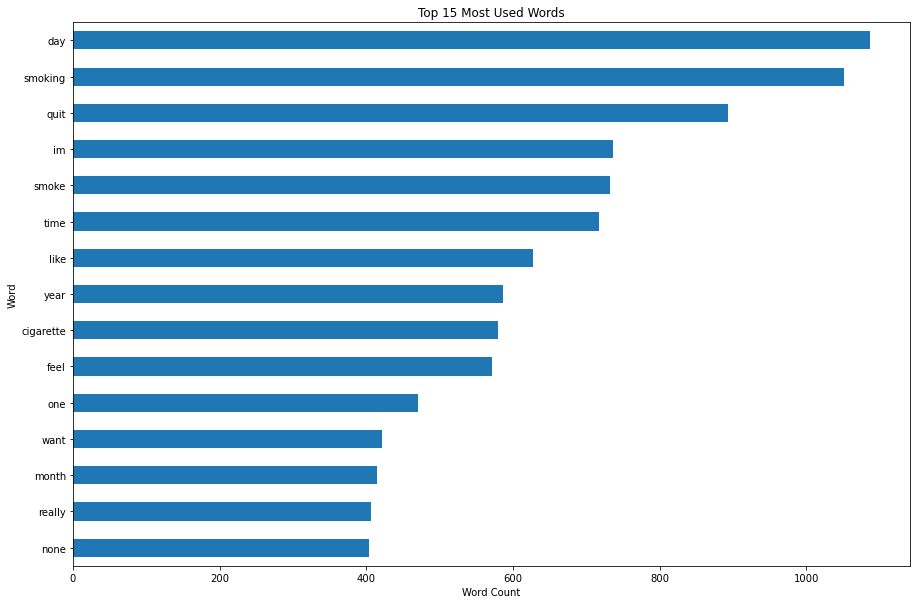

In [233]:
#create a horizontal Bar plot to visualize the top 15 words
plt.figure(figsize=(15,10))
filtered_messages_selftext_matrix.sum().sort_values(ascending=True).tail(15).plot(kind='barh')
plt.xlabel('Word Count')
plt.ylabel('Word')
plt.title('Top 15 Most Used Words')

## N-Grams for Selftext: Create function to remove punctuation, tokenize, remove stopwords, and lemmatize

In [234]:
def clean_text(text_of_selftext):
    text_of_selftext = "".join([word.lower() for word in text_of_selftext if word not in string.punctuation])
    self_tokens = re.split('\W+', text_of_selftext)
    # Requires a full sentence to be passed in as opposed to a tokenized list
    text_of_selftext = " ".join([wn.lemmatize(word) for word in self_tokens if word not in stopwords])
    return text_of_selftext

filtered_messages['cleaned_token_selftext'] = filtered_messages['selftext'].apply(lambda x: clean_text(x))
filtered_messages.head()

,author,title,selftext,subreddit,title_clean,title_clean_tokenized,title_clean_nostopwords,title_clean_lemmatized,cleaned_token_title,cleaned_token_selftext
0,Late_Night_Drives,"It's possible, my friends. Difficult, but possible!","I'm now at 100 days. I can't believe it honestly. It was super difficult but I'm glad I did it. Honestly at this point the cravings aren't troublesome, however still existent. I think I won't be returning to this habit. \n\nAt one point due to my addiction, consuming nicotine became my personality. I was constantly inhaling this garbage. Literally every couple of minutes I needed to take a hit. My health started to deteriorate, blood levels weren't normal and doctors started to get concerned. I still didn't give a fuck. I was very stubborn. One day however, breathing just became impossible. I'm now on two inhalers as a result. It scares me straight. \n\nTrust me when I say this, it's possible to quit. It's not impossible. Don't be like me and have to deal with a health consequence (hopefully temporary) to motivate you to quit. Let my health problems motivate you to do better.\n\nIf you're considering quitting, I believe in you! If I can do it, so can you.",stopsmoking,Its possible my friends Difficult but possible,"[its, possible, my, friends, difficult, but, possible]","[possible, friends, difficult, possible]","[possible, friend, difficult, possible]",possible friend difficult possible,im 100 day cant believe honestly super difficult im glad honestly point craving arent troublesome however still existent think wont returning habit one point due addiction consuming nicotine became personality constantly inhaling garbage literally every couple minute needed take hit health started deteriorate blood level werent normal doctor started get concerned still didnt give fuck stubborn one day however breathing became impossible im two inhaler result scare straight trust say possible quit impossible dont like deal health consequence hopefully temporary motivate quit let health problem motivate better youre considering quitting believe
1,countrycow2112,Made it to 18 months. It's deffo for forever this time!,None,stopsmoking,Made it to 18 months Its deffo for forever this time,"[made, it, to, 18, months, its, deffo, for, forever, this, time]","[made, 18, months, deffo, forever, time]","[made, 18, month, deffo, forever, time]",made 18 month deffo forever time,none
2,Altruistic_Ad5297,I need help,"I've been a heavy smoker for a quite sometime smoking around 2 packs a day I quit few times the longest being around 2.5 months, around a month and half ago I decided I want to take better care of myself and my health and work on my running (my biggest dream is to become an elite runner and that doesn't really go well with smoking.)\n\nI've been doing great, Ive felt like I've been happy for the first time in so long and I was feeling like I can breath on my runs for the first time ever, but this weekend I went on a vacation with some co-workers and I got so drunk and smoked so much.\n\nI told myself that I'm in control and I won't let this be my relapse, I made it for a couple of days but today I smoked two cigarettes.\n\nI feel crushed and I'm losing meaning of life, I don't want to go back to the smoking life and I also don't want to live my life moping for a cigarette, I really don't know what to do I feel like I hate myself and my life. I'm stuck in a loop that I don't know how to get out.\n\nMaybe it's worth mentioning that I live with two roommates that both smokes and the smell is so triggering I can't begin to describe it. \n\nHow did you break the loop? does it ever get better?\n\nI feel like I'm a hopeless case and I don't want to live like this anymore, I really need some advice on how to not relapse again.",stopsmoking,I need help,"[i, need, help]","[need, help]","[need, help]",need help,ive heavy smoker quite sometime smoking around 2 pack day quit time longest around 25 month around month half ago decide

## N-Gram for Selftext: Apply CountVectorizer

In [235]:
from sklearn.feature_extraction.text import CountVectorizer

# ngram_range refers to the range of n-grams that we would like to look for. 
selftext_ngram_vect = CountVectorizer(ngram_range=(2,2))
selftext_X_counts = selftext_ngram_vect.fit_transform(filtered_messages['cleaned_token_selftext'])

# Data Set has 94781 unique 2-word combinations
print(selftext_X_counts.shape)

print(selftext_ngram_vect.get_feature_names())

(1995, 62161)
['0000 im', '030 year', '0mg able', '0mg kicked', '0mg nicotine', '0mg throw', '0mg vape', '10 12', '10 20', '10 average', '10 can', '10 cigarette', '10 cigs', '10 day', '10 fucking', '10 get', '10 gift', '10 hour', '10 id', '10 improvement', '10 layer', '10 meter', '10 mile', '10 min', '10 minute', '10 month', '10 night', '10 pill', '10 pound', '10 puff', '10 pull', '10 quit', '10 radical', '10 really', '10 remember', '10 smoke', '10 smoking', '10 stick', '10 time', '10 week', '10 year', '100 also', '100 certainty', '100 copd', '100 day', '100 feel', '100 fold', '100 funny', '100 glad', '100 head', '100 help', '100 illusion', '100 ngml', '100 people', '100 per', '100 sober', '100 successfully', '100 sure', '100 thing', '100 till', '100 time', '100 withdrawl', '100 worth', '1000 certainly', '1000 day', '1000 enough', '1000 shitty', '1000 time', '10000 right', '100000 cigarette', '10000x enjoyable', '1000th quit', '1000x harder', '100k user', '100th attempt', '100w box', '

## N-Gram for Selftext: Apply CountVectorizer to smaller sample

In [236]:
#filter out top 1500 rows of titles
filtered_messages_sample = filtered_messages[0:1500]

#instantiate the CountVectorizer object
#transforms the body text into features
#create columns with word counts for each comment
self_ngram_vect_sample = CountVectorizer(ngram_range=(2,2), max_features=100)

#do a fit transform to the vectorizer
selftext_X_counts_sample = self_ngram_vect_sample.fit_transform(filtered_messages_sample['cleaned_token_selftext'])

#print out results
print(selftext_X_counts_sample.shape)
print("\n")
print(self_ngram_vect_sample.get_feature_names())

(1500, 100)


['10 day', '10 year', '20 year', 'anyone else', 'back smoking', 'brain fog', 'buy pack', 'cigarette day', 'cold turkey', 'couple day', 'couple week', 'day ago', 'day without', 'decided quit', 'dont even', 'dont know', 'dont think', 'dont want', 'even though', 'every day', 'every time', 'feel better', 'feel like', 'feeling like', 'felt like', 'first day', 'first time', 'first week', 'get better', 'go away', 'go back', 'going back', 'good luck', 'heavy smoker', 'im going', 'im sure', 'ive never', 'ive quit', 'ive tried', 'last cigarette', 'last day', 'last month', 'last night', 'last time', 'last week', 'last year', 'like im', 'like smoke', 'make feel', 'many time', 'month ago', 'much better', 'next day', 'nicotine free', 'nicotine withdrawal', 'non smoker', 'one cigarette', 'one day', 'pack day', 'per day', 'pretty much', 'quit cold', 'quit month', 'quit smoking', 'quit time', 'quitting smoking', 'really bad', 'really want', 'seems like', 'since quit', 'smoke break', 'smok

## Vectorizers output sparse matrices

In [237]:
selftext_X_counts_sample

<1500x100 sparse matrix of type '<class 'numpy.int64'>'
	with 2911 stored elements in Compressed Sparse Row format>

In [238]:
# Due to the nature of sparse matrices where only non-zero elements are stored, 
# we would need to expand it out to a collection of arrays and then store it in a data frame
selftext_X_counts_df_sample = pd.DataFrame(selftext_X_counts_sample.toarray())
selftext_X_counts_df_sample

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,2,0,3,0,0,0,0,2,1,1,0,2,0,1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0
5,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
7,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
8,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
9,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [239]:
#save the file as a backup
selftext_X_counts_df_sample.to_csv('../data/BACKUP/SS_NGrams_Selftext_X_Counts_of_Sample.csv')

In [240]:
#create a NumPy array from x counts sample
#create a new dataframe 'x_counts_df'
selftext_sample_X_counts_df = pd.DataFrame(selftext_X_counts_sample.toarray())

#create column names from the feature names
selftext_sample_X_counts_df.columns = self_ngram_vect_sample.get_feature_names()

#display output df
selftext_sample_X_counts_df

,10 day,10 year,20 year,anyone else,back smoking,brain fog,buy pack,cigarette day,cold turkey,couple day,couple week,day ago,day without,decided quit,dont even,dont know,dont think,dont want,even though,every day,every time,feel better,feel like,feeling like,felt like,first day,first time,first week,get better,go away,go back,going back,good luck,heavy smoker,im going,im sure,ive never,ive quit,ive tried,last cigarette,last day,last month,last night,last time,last week,last year,like im,like smoke,make feel,many time,month ago,much better,next day,nicotine free,nicotine withdrawal,non smoker,one cigarette,one day,pack day,per day,pretty much,quit cold,quit month,quit smoking,quit time,quitting smoking,really bad,really want,seems like,since quit,smoke break,smoke free,smoke one,smoked cigarette,smoking cigarette,smoking since,smoking vaping,smoking year,started smoking,stop smoking,stopped smoking,time quit,tried quit,try quit,trying quit,two week,urge smoke,used smoke,want quit,want smoke,want stop,week ago,wish luck,withdrawal symptom,without cigarette,without smoking,would like,year ago,year old,year smoking
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,2,0,3,0,0,0,0,2,1,1,0,2,0,1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0
5,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
7,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
8,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
9,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


## EDA: Find out what are the top words used for N-Grams Selftext Column

In [241]:
#create a feature name dataframe for title column
filtered_messages_selftext_matrix = pd.DataFrame(selftext_sample_X_counts_df, columns=self_ngram_vect_sample.get_feature_names())

#showcase the top 50 words used in the title column 
filtered_messages_selftext_matrix.sum().sort_values(ascending=False).head(50)

feel like             179
quit smoking          141
cold turkey           105
pack day               68
year ago               64
dont want              61
stop smoking           61
anyone else            56
started smoking        54
month ago              54
every day              52
smoke free             51
dont know              51
first day              48
day ago                46
10 year                46
want quit              46
want smoke             46
quitting smoking       42
first time             42
trying quit            41
last cigarette         38
cigarette day          38
week ago               37
really want            36
first week             35
every time             35
one day                34
last year              34
im going               32
year old               32
quit cold              32
felt like              31
stopped smoking        31
couple day             29
since quit             29
even though            28
non smoker             28
go back     

Text(0.5, 1.0, 'Top 15 Most Used Paired Words')

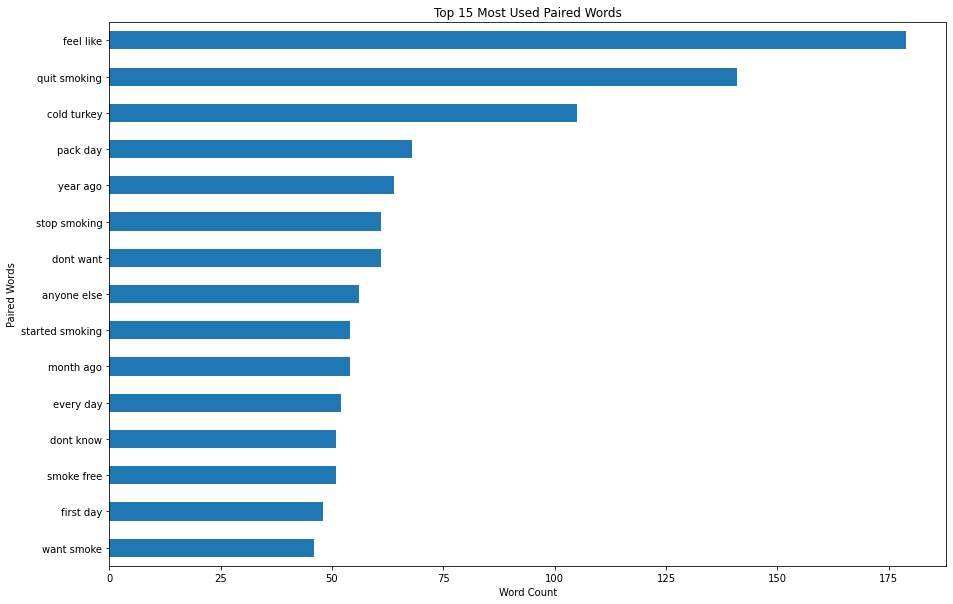

In [242]:
#create a horizontal Bar plot to visualize the top 15 paired words
plt.figure(figsize=(15,10))
filtered_messages_selftext_matrix.sum().sort_values(ascending=True).tail(15).plot(kind='barh')
plt.xlabel('Word Count')
plt.ylabel('Paired Words')
plt.title('Top 15 Most Used Paired Words')

In [243]:
#add subreddit column to the selftext_sample_X_counts_df to complete the data set
selftext_sample_X_counts_df['subreddit'] = filtered_messages['subreddit']

In [244]:
#check sample to make sure the subreddit column is added
selftext_sample_X_counts_df.head()

,10 day,10 year,20 year,anyone else,back smoking,brain fog,buy pack,cigarette day,cold turkey,couple day,couple week,day ago,day without,decided quit,dont even,dont know,dont think,dont want,even though,every day,every time,feel better,feel like,feeling like,felt like,first day,first time,first week,get better,go away,go back,going back,good luck,heavy smoker,im going,im sure,ive never,ive quit,ive tried,last cigarette,last day,last month,last night,last time,last week,last year,like im,like smoke,make feel,many time,month ago,much better,next day,nicotine free,nicotine withdrawal,non smoker,one cigarette,one day,pack day,per day,pretty much,quit cold,quit month,quit smoking,quit time,quitting smoking,really bad,really want,seems like,since quit,smoke break,smoke free,smoke one,smoked cigarette,smoking cigarette,smoking since,smoking vaping,smoking year,started smoking,stop smoking,stopped smoking,time quit,tried quit,try quit,trying quit,two week,urge smoke,used smoke,want quit,want smoke,want stop,week ago,wish luck,withdrawal symptom,without cigarette,without smoking,would like,year ago,year old,year smoking,subreddit
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,stopsmoking
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,stopsmoking
2,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,2,0,3,0,0,0,0,2,1,1,0,2,0,1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,stopsmoking
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,stopsmoking
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,stopsmoking


To get the best result for the study, we have decided to filter down the previous cleaned dataframes to just 'selftext' and 'subreddit' columns.  This is because the 'selftext' column contains the "meat" of each author's post which gives the computer more information to study on.  The 'subreddit' column will train the system to understand where the 'selftext' belongs to so it can associate some of the words to the proper subreddit.

In [245]:
#this will be used for Naive Bayes later
selftext_sample_X_counts_df.to_csv("../data/BACKUP/SS_NGrams_Selftext_X_Count_DF.csv")

## Create a Wordcloud to visually see what are the top 100 words used most commoly in Stop Smoking
___

In [246]:
from PIL import Image
import numpy as np
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator

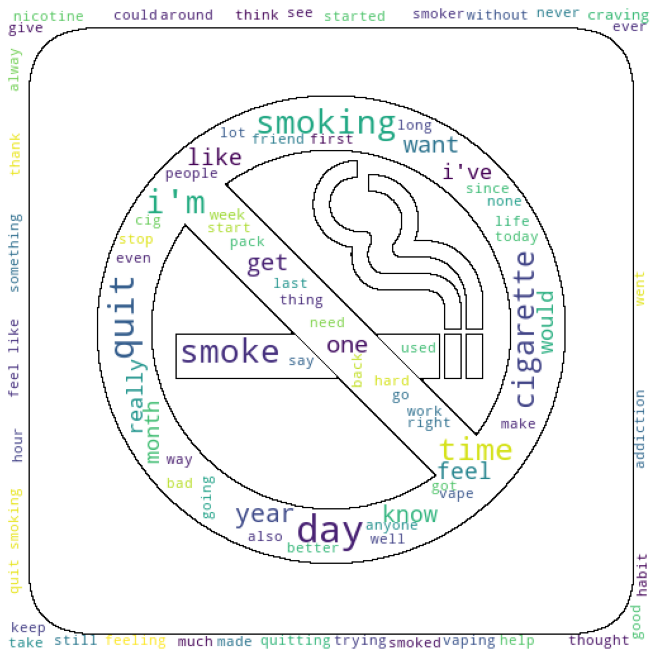

In [247]:
#Before preprocessing the dataset i.e. Remove punctuations, Tokenization, Remove stopwords,Lemmatize,
#Let's visualize the top 100 words in each subreddit (alcoholics_final, smoking_final)
#Reference: https://www.geeksforgeeks.org/generating-word-cloud-python/


#Visualize top 100 words in alcoholics anonymous
text = ''
stopwords = nltk.corpus.stopwords.words('english')
 
# iterate through train
for val in filtered_messages_df.selftext:
     
    # typecaste each val to string
    val = str(val)
 
    # split the value
    tokens = val.split()
     
    # Converts each token into lowercase
    for i in range(len(tokens)):
        tokens[i] = tokens[i].lower()      
     
    text += " ".join(tokens)+" "
    
mask = np.array(Image.open("../img/smoke.png"))

wordcloud = WordCloud(max_words= 100,
                      width = 3200, height = 3200,
                      mask=mask,
                      background_color ='white',
                      stopwords = stopwords,
                      contour_width=1,
                      contour_color='black',
                      min_font_size = 10).generate(text)
 
# plot the WordCloud image                      
plt.figure(figsize = (9,9), facecolor = None)
plt.imshow(wordcloud)
plt.axis("off")
plt.tight_layout(pad = 0)
 
plt.show()